In [1]:
%cd ..
%ls

/home/nas3_userJ/dmkim/OnlineTSAD
cfgs/         data/  Exp/   models/   plots/    test.py*   utils/  wandb/
checkpoints/  EDA/   logs/  outputs/  results/  train.py*  Vis/


In [2]:
import torch
from torch import optim
import torch.nn.functional as F

import matplotlib.pyplot as plt

from utils.metrics import get_summary_stats

from models.MLP import MLP

import wandb
import hydra
from omegaconf import DictConfig

from utils.logger import make_logger
from utils.argpass import prepare_arguments, configure_exp_id
from utils.tools import SEED_everything, plot_interval

import warnings
from data.load_data import DataFactory
from Exp.ReconBaselines import *

from easydict import EasyDict as edict
import yaml
import re
import copy

warnings.filterwarnings("ignore")

In [4]:
# load yaml
cfg = {}
loader = yaml.SafeLoader
loader.add_implicit_resolver(
    u'tag:yaml.org,2002:float',
    re.compile(u'''^(?:
     [-+]?(?:[0-9][0-9_]*)\\.[0-9_]*(?:[eE][-+]?[0-9]+)?
    |[-+]?(?:[0-9][0-9_]*)(?:[eE][-+]?[0-9]+)
    |\\.[0-9_]+(?:[eE][-+][0-9]+)?
    |[-+]?[0-9][0-9_]*(?::[0-5]?[0-9])+\\.[0-9_]*
    |[-+]?\\.(?:inf|Inf|INF)
    |\\.(?:nan|NaN|NAN))$''', re.X),
    list(u'-+0123456789.'))

# get cfg
model = "MLP"
with open("cfgs/test_defaults.yaml", "r") as file:
    basic_config = yaml.load(file, Loader=loader)
    cfg.update(basic_config)
with open(f"cfgs/model/{model}.yaml", "r") as file:
    model_config = yaml.load(file, Loader=loader)
    cfg.update({"model": model_config})
cfg['dataset'] = 'SMD'

In [5]:
args = prepare_arguments(cfg)
args.model.latent_dim = 128
args.window_size = 12
args.eval_batch_size = 1
args.dataset = "SMD"
print(args)

logger = make_logger(os.path.join(args.log_path, f'{args.exp_id}.log'))
logger.info(f"Configurations: {args}")

# Data
logger.info(f"Preparing {args.dataset} dataset...")
datafactory = DataFactory(args, logger)
train_dataset, train_loader, test_dataset, test_loader = datafactory()
args.num_channels = train_dataset.X.shape[1]
train_X, train_y, test_X, test_y = train_dataset.X, train_dataset.y, test_dataset.X, test_dataset.y

print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[2023-04-02 20:05:28,746] Configurations: {'exp_id': 'MLP_SMD', 'infer_options': ['offline', 'online_us_bce_seq', 'online_us_focal_seq', 'online_us_bce_joint', 'online_us_focal_joint', 'online_label_bce_seq', 'online_label_focal_seq', 'online_label_bce_joint', 'online_label_focal_joint'], 'dataset': 'SMD', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_SMD', 'log_path': './logs/MLP_SMD', 'output_path': './outputs/MLP_SMD', 'plot_path': './plots/MLP_SMD', 'result_path': './results/MLP_SMD', 'defaults': [{'model': 'OCSVM'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}
[2023-04-02 20:05:28,747] Preparing SMD dataset...
[2023-04-02 20:05:28,748] current location: /home/nas3_userJ/dmkim/OnlineTSAD
[2023-04-02 20:05:28,749] Preparing SMD ...

{'exp_id': 'MLP_SMD', 'infer_options': ['offline', 'online_us_bce_seq', 'online_us_focal_seq', 'online_us_bce_joint', 'online_us_focal_joint', 'online_label_bce_seq', 'online_label_focal_seq', 'online_label_bce_joint', 'online_label_focal_joint'], 'dataset': 'SMD', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_SMD', 'log_path': './logs/MLP_SMD', 'output_path': './outputs/MLP_SMD', 'plot_path': './plots/MLP_SMD', 'result_path': './results/MLP_SMD', 'defaults': [{'model': 'OCSVM'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cuda')}


[2023-04-02 20:05:29,317] train: X - (708405, 38), y - (708405,) test: X - (708420, 38), y - (708420,)
[2023-04-02 20:05:29,430] Complete.
[2023-04-02 20:05:29,431] Preparing dataloader...
[2023-04-02 20:05:30,581] total train dataset- 11069, batch_X - torch.Size([64, 12, 38]), batch_y - torch.Size([64, 12])
[2023-04-02 20:05:30,583] total test dataset- 59035, batch_X - torch.Size([1, 12, 38]), batch_y - torch.Size([1, 12])
[2023-04-02 20:05:30,584] Complete.


(708405, 38) (708405,) (708420, 38) (708420,)


## Visualize

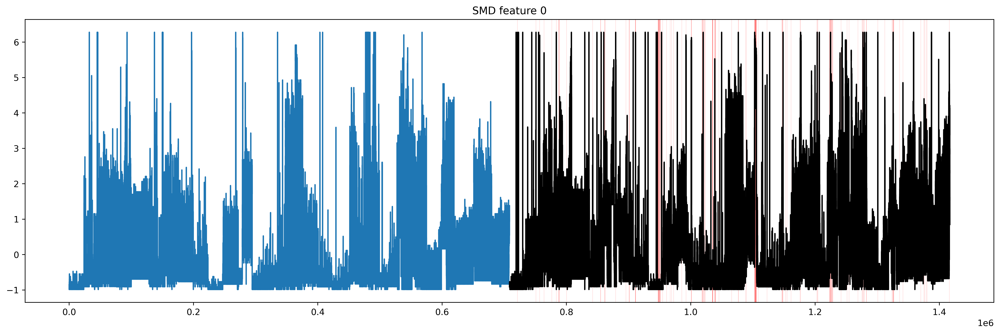

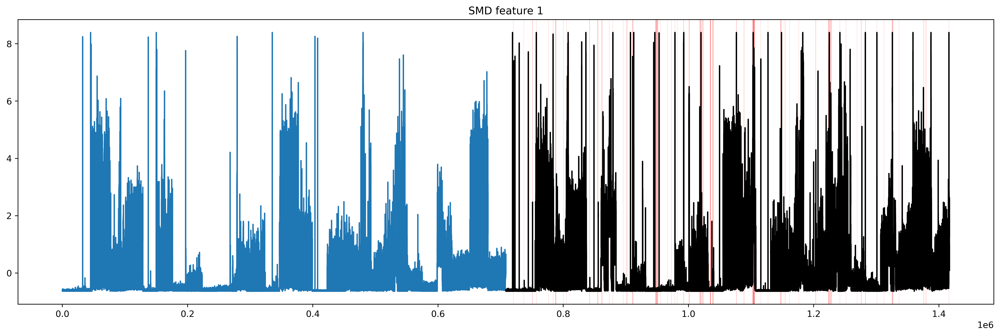

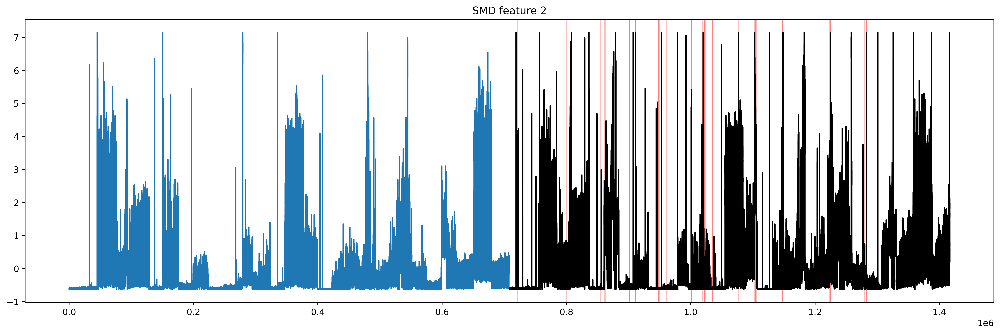

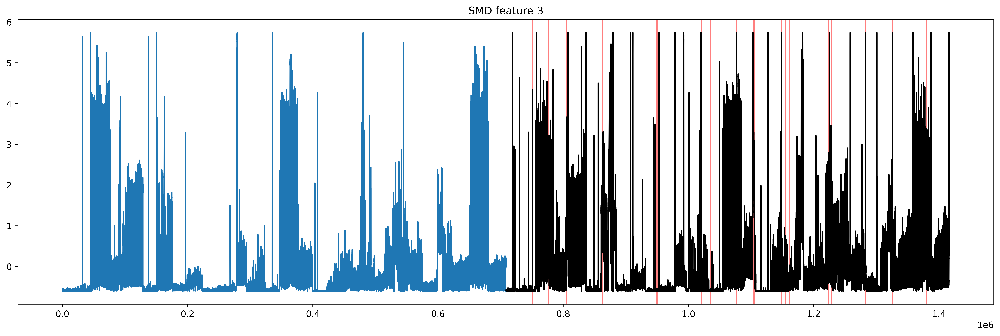

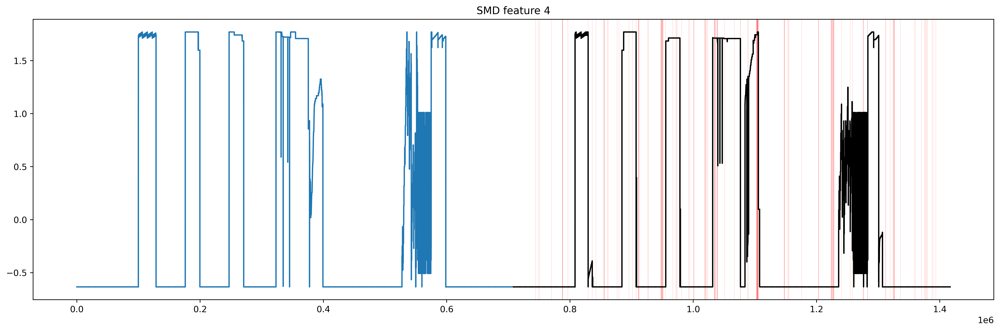

...

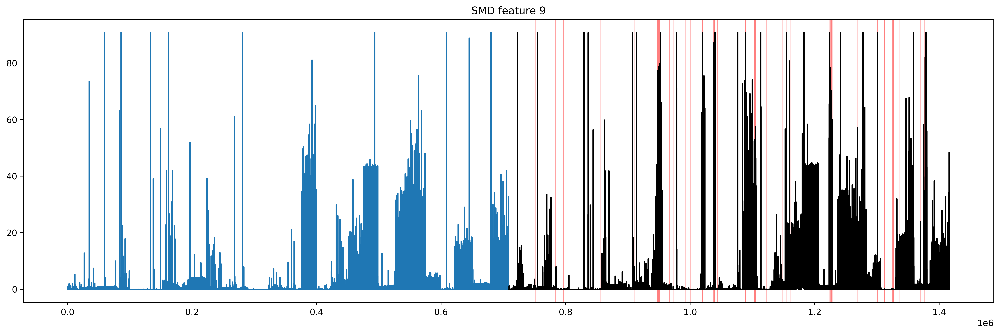

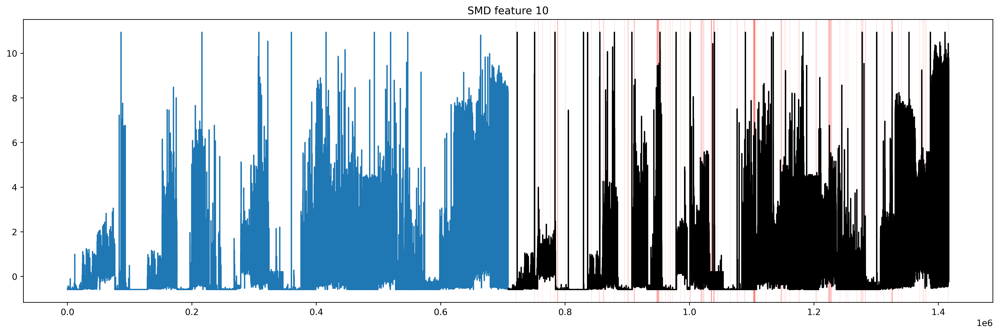

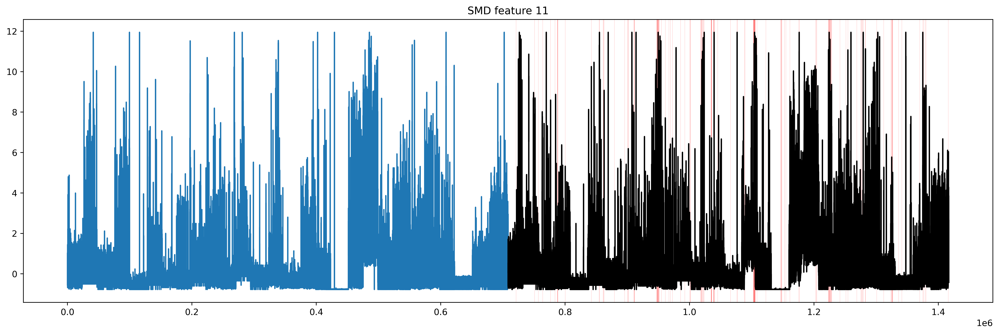

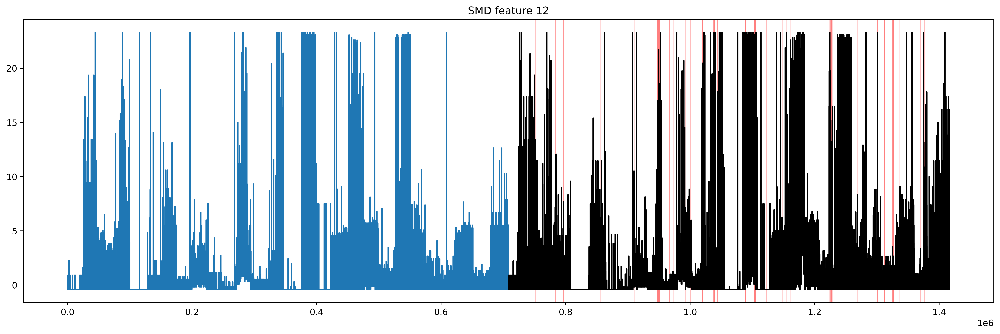

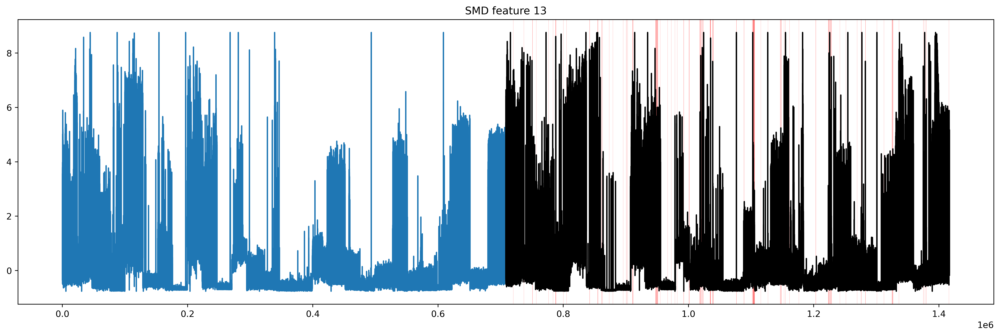

KeyboardInterrupt: 

In [6]:
for c in range(args.num_channels):
    dataset_name = "SMD"
    plt.figure(figsize=(20, 6), dpi=500)
    plt.plot(train_X[:, c], color="C0")
    plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black")
    label = np.concatenate([np.array([0]*len(train_X)), test_y])
    plot_interval(plt, label)
    plt.title(f"{dataset_name} feature {c}")
    plt.show()

## Load Model

In [7]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SMD", f"best.pth"))

[2023-04-02 20:07:14,231] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict
[2023-04-02 20:07:14,660] train_errors.pt file exists, loading...
[2023-04-02 20:07:15,359] torch.Size([708394, 12])
[2023-04-02 20:07:15,615] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict


In [8]:
next(iter(tester.model.parameters())).device, next(iter(tester.model.parameters())).requires_grad

(device(type='cuda', index=0), True)

## Training statistics

In [9]:
train_iterator = tqdm(
    tester.train_loader,
    total=len(tester.train_loader),
    desc="calculating reconstruction errors",
    leave=True
)

recon_errors = []
with torch.no_grad():
    for i, batch_data in enumerate(train_iterator):
        X = batch_data[0].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        recon_error = torch.nn.functional.mse_loss(Xhat, X, reduction='none')
        recon_errors.append(recon_error)

recon_errors = torch.cat(recon_errors, axis=0)

train_error_dist = recon_errors.mean(dim=(1, 2))

print(f"{recon_errors.shape}, {train_error_dist.shape}")

calculating reconstruction errors: 100%|██████████| 11069/11069 [00:18<00:00, 600.85it/s]

torch.Size([708394, 12, 38]), torch.Size([708394])


## Test: static threshold inference

In [10]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

anoscs_prev = []
Xhats_prev = []
with torch.no_grad():
    for i, batch_data in enumerate(eval_iterator):
        X, y = batch_data[0].to(args.device), batch_data[1].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        Xhats_prev.append(Xhat)        
        e = F.mse_loss(Xhat, X, reduction='none')
        anosc = e.mean(dim=2)
        anoscs_prev.append(anosc)

Xhats_prev = torch.cat(Xhats_prev, axis=0).detach().cpu().numpy()
anoscs_prev = torch.cat(anoscs_prev, axis=0).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 59035/59035 [00:43<00:00, 1344.41it/s]


In [11]:
th_q95 = torch.quantile(train_error_dist, 0.95).item()
th_q99 = torch.quantile(train_error_dist, 0.99).item()
th_q100 = torch.max(train_error_dist).item()
th_best_static = tester.get_best_static_threshold(gt=test_y, anomaly_scores=anoscs_prev)
th_q95, th_q99, th_q100, th_best_static

[2023-04-02 20:08:18,854] Best threshold found at: 0.4767266809940338, with fpr: 0.040304811952116125, tpr: 0.28338540959108816
tn: 651611 fn: 21100
fp: 27365 tp: 8344


(0.11733493953943253, 0.3433779180049896, 1244.027099609375, 0.47672668)

In [12]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

{'Accuracy': 0.8444072725219502, 'Precision': 0.13930934712138665, 'Recall': 0.529819318027442, 'F1': 0.22061163160685876, 'tn': 582595, 'fp': 96381, 'fn': 13844, 'tp': 15600}
{'Accuracy': 0.9185031478501454, 'Precision': 0.20587623721201032, 'Recall': 0.33626545306344247, 'F1': 0.25539104416013203, 'tn': 640785, 'fp': 38191, 'fn': 19543, 'tp': 9901}
{'Accuracy': 0.9584977838005703, 'Precision': 0.9574468085106383, 'Recall': 0.0015283249558483902, 'F1': 0.0030517785086975687, 'tn': 678974, 'fp': 2, 'fn': 29399, 'tp': 45}
{'Accuracy': 0.9315843708534485, 'Precision': 0.23363857850961942, 'Recall': 0.28335144681429153, 'F1': 0.2561048608659617, 'tn': 651610, 'fp': 27366, 'fn': 21101, 'tp': 8343}


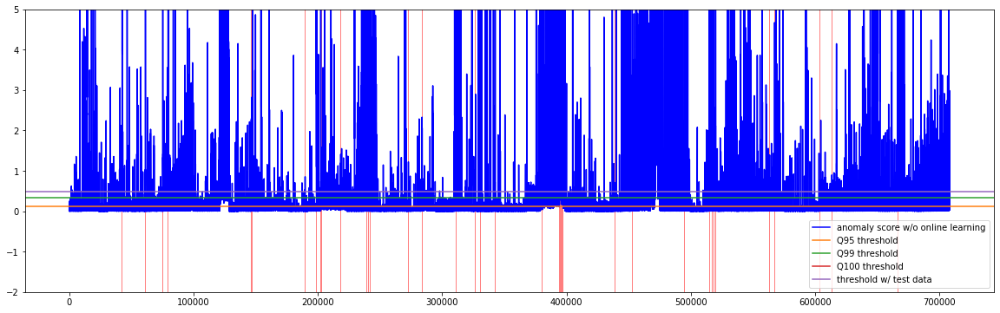

In [13]:
plt.figure(figsize=(20, 6))
plt.ylim([-2, 5])
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
#plt.plot(anoscs, color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")

#plt.plot(thrs, color="gold",label="dynamic threshold")
plt.legend()
plot_interval(plt, test_y)
plt.show()

## EMA

## Value-based Pseudo-label guided Online Learning (separate threshold)

### 1. Single+CE

In [35]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.1173, requires_grad=True)

In [36]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SMD", f"best.pth"))

[2023-04-02 20:33:07,199] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict
[2023-04-02 20:33:07,218] train_errors.pt file exists, loading...
[2023-04-02 20:33:07,243] torch.Size([708394, 12])
[2023-04-02 20:33:07,499] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict


In [37]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
TH_optimizer = torch.optim.SGD([thr], lr=1e-05)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    #if i*L >= 23000:
    #    import pdb;pdb.set_trace();
        
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    # update threshold
    TH_optimizer.zero_grad()
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    yhat = torch.sigmoid((A-thr))
    cls_loss = bce(yhat, ytilde)
    cls_loss.backward()
    TH_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 59035/59035 [05:25<00:00, 181.37it/s]


In [38]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(708420,) (708420,)
{'Accuracy': 0.9260678693430451, 'Precision': 0.22718728436481309, 'Recall': 0.32427659285423177, 'F1': 0.26718529193658963, 'tn': 646497, 'fp': 32479, 'fn': 19896, 'tp': 9548}


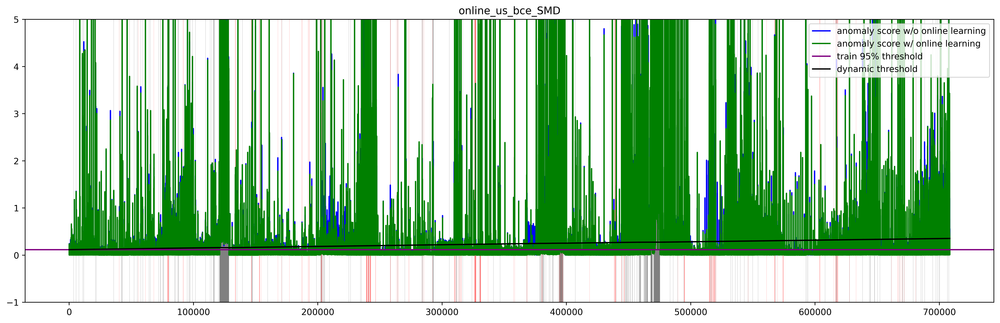

In [39]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=1)
plt.legend()
plt.show()

### Single + BCE + Joint

In [19]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.1173, requires_grad=True)

In [20]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SMD", f"best.pth"))

[2023-04-02 20:15:27,917] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict
[2023-04-02 20:15:27,937] train_errors.pt file exists, loading...
[2023-04-02 20:15:27,975] torch.Size([708394, 12])
[2023-04-02 20:15:28,186] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict


In [21]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, ytilde.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 59035/59035 [03:30<00:00, 279.93it/s]


In [22]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

(708420,) (708420,)
{'Accuracy': 0.9585867140961577, 'Precision': 0.5257281553398059, 'Recall': 0.036781687270751255, 'F1': 0.06875317420010156, 'tn': 677999, 'fp': 977, 'fn': 28361, 'tp': 1083}


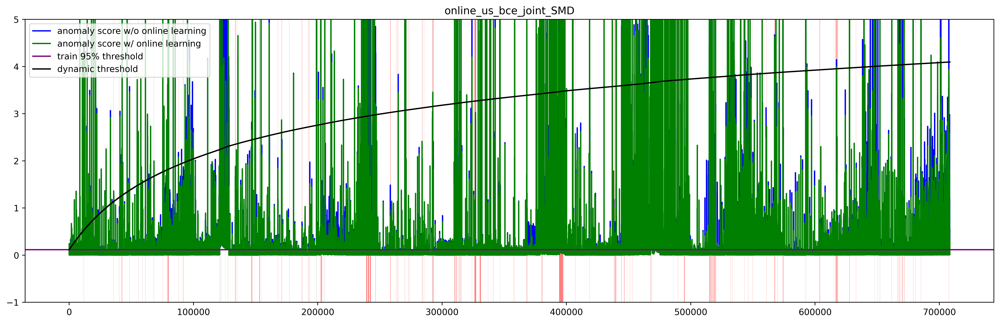

In [23]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_joint_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

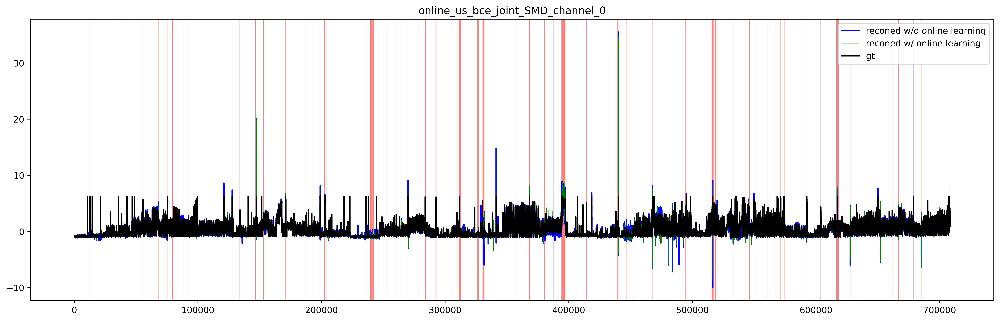

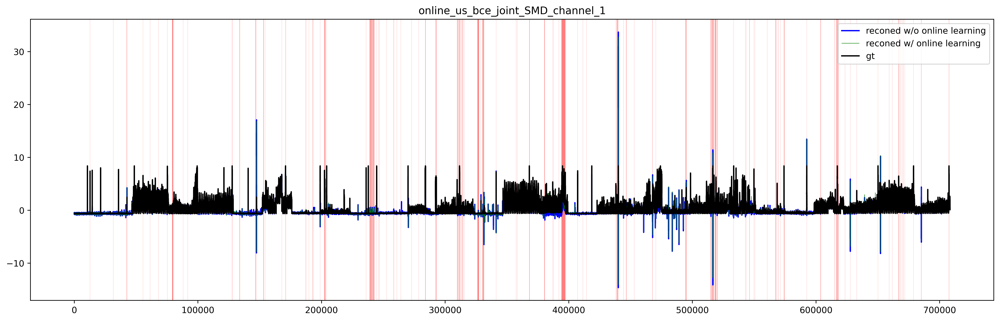

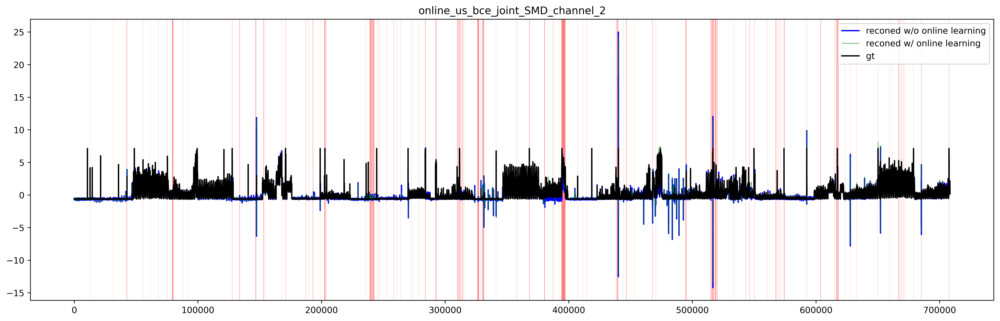

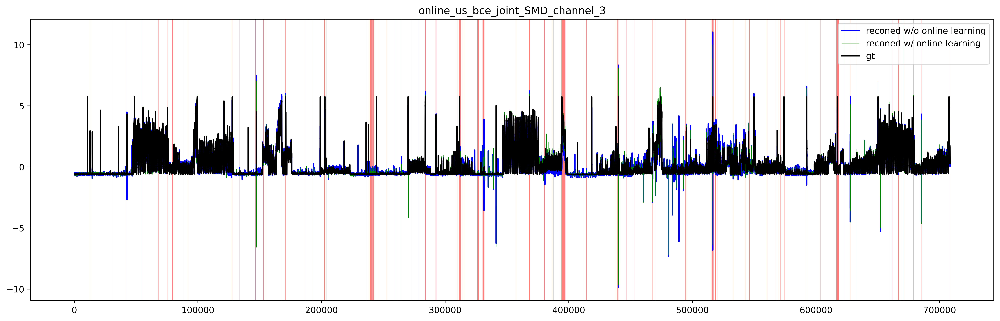

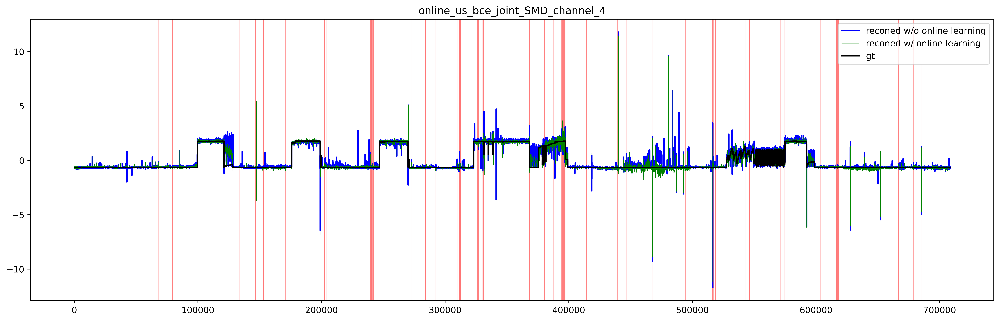

...

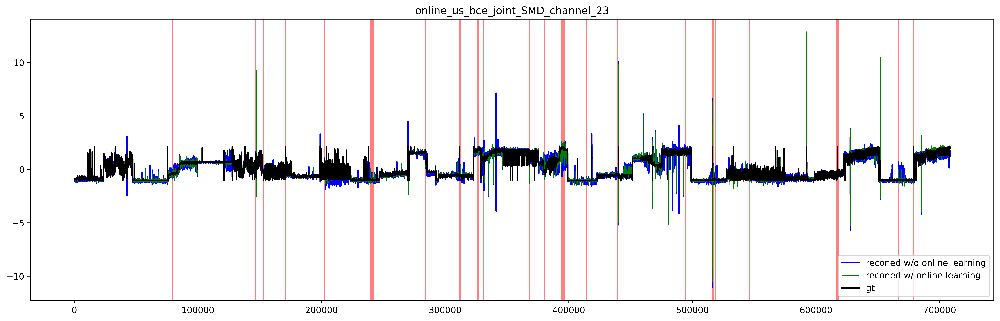

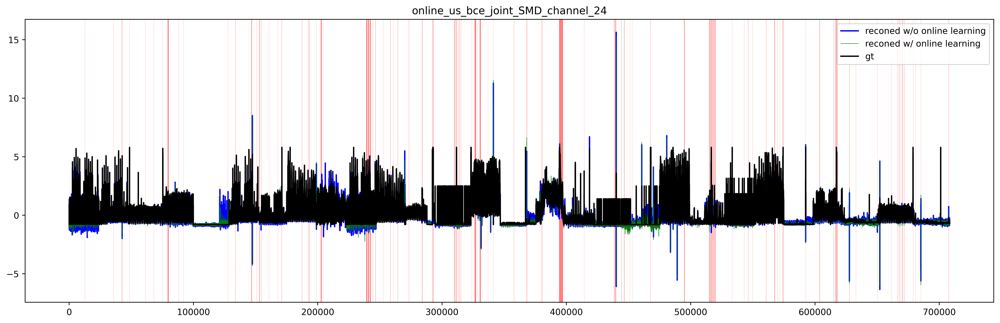

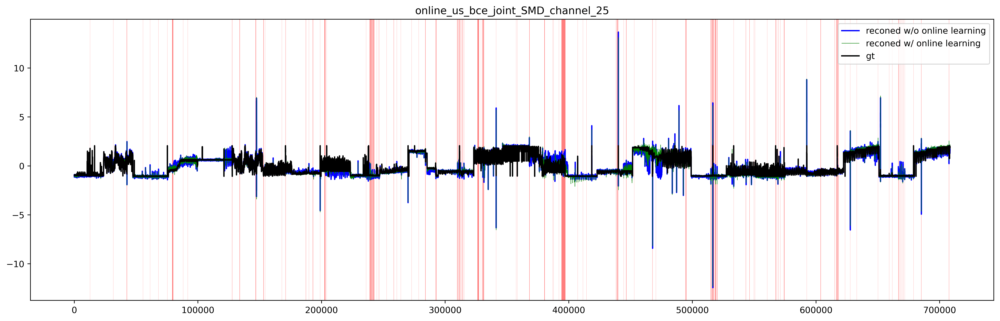

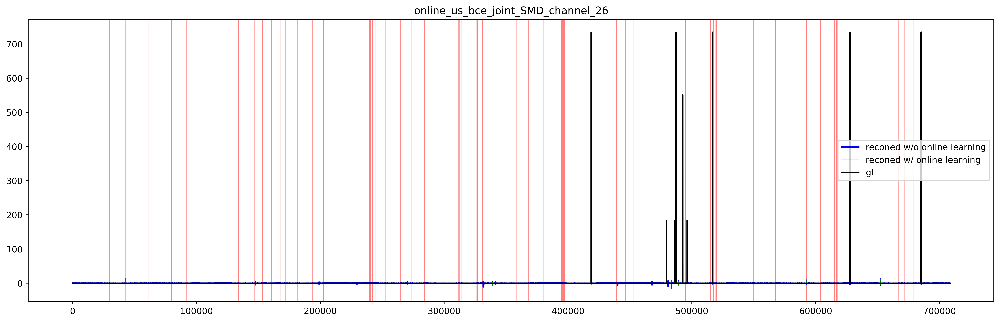

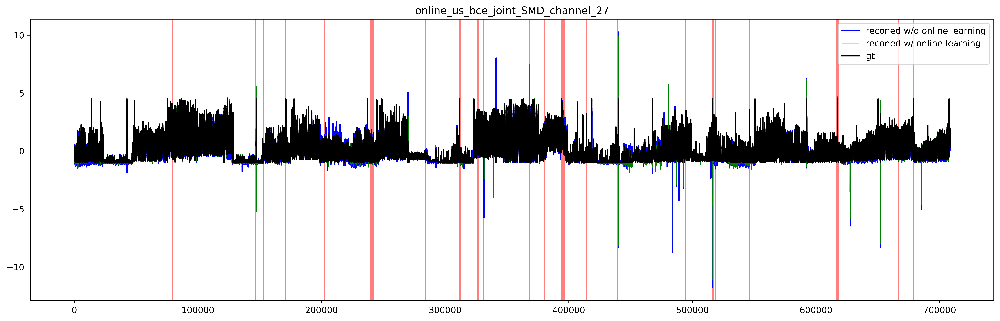

Error in callback <function flush_figures at 0x7f7fa778ff70> (for post_execute):


KeyboardInterrupt: 

In [24]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)

### Single + BCE + Label

In [27]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.1173, requires_grad=True)

In [28]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_SMD", f"best.pth"))

[2023-04-02 20:26:04,241] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict
[2023-04-02 20:26:04,248] train_errors.pt file exists, loading...
[2023-04-02 20:26:04,283] torch.Size([708394, 12])
[2023-04-02 20:26:04,526] loading: ./checkpoints/MLP_SMD/best.pth @Trainer - torch.load_state_dict


In [29]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (y == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, y.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 59035/59035 [03:28<00:00, 282.61it/s]


In [30]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

(708420,) (708420,)
{'Accuracy': 0.9708223934953841, 'Precision': 0.8812793325221624, 'Recall': 0.34438255671783724, 'F1': 0.49523809523809526, 'tn': 677610, 'fp': 1366, 'fn': 19304, 'tp': 10140}


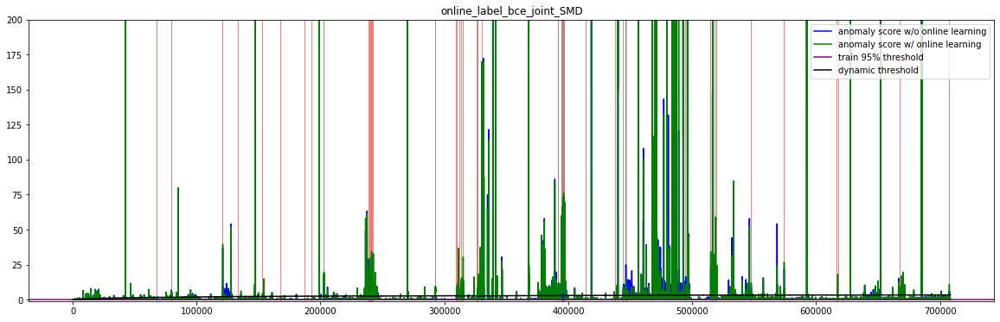

In [34]:
s, e = 0, -1
plt.figure(figsize=(20, 6))#, dpi=500)
plt.title(f"online_label_bce_joint_{args.dataset}")
plt.ylim([-1, 200])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.legend()
    plot_interval(plt, test_y)